In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
import torch
from PIL import Image
import os
import re
from tqdm import tqdm
import matplotlib.pyplot as plt
from torch.utils.data import Dataset

import torchvision.transforms as T
from tqdm import tqdm, tqdm_notebook
import torch.nn as nn
import torch.optim as optim

import tensorflow as tf
from keras.preprocessing import image
from tensorflow.keras.preprocessing import image
from keras.applications.resnet50 import ResNet50, preprocess_input
from keras.applications.vgg16 import VGG16
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.neighbors import NearestNeighbors
from numpy.linalg import norm
import pickle
import matplotlib.image as mpimg
import pandas as pd
import numpy as np
import math
import time

In [3]:
physical_devices = tf.config.experimental.list_physical_devices('GPU')
assert len(physical_devices) > 0, "Not enough GPU hardware devices available"
config = tf.config.experimental.set_memory_growth(physical_devices[0], True)

# 새 섹션

In [4]:
model = ResNet50(weights='imagenet', include_top=False, input_shape=(224, 224, 3), pooling='max')

94765736/94765736 [==============================] - 0s 0us/step


In [5]:
def extract_features(img_path, model):

    input_shape = (224, 224, 3)
    img = image.load_img(img_path, target_size=(input_shape[0], input_shape[1]))
    img_array = image.img_to_array(img)

    expanded_img_array = np.expand_dims(img_array, axis=0)

    preprocessed_img = preprocess_input(expanded_img_array)

    features = model.predict(preprocessed_img)

    normalized_features = features / norm(features)

    return normalized_features

In [6]:
features = extract_features('/content/drive/MyDrive/캡스톤/데이터/연극/연극_포스터/대학로 1위 연극 〈쉬어매드니스〉.png', model)[0]
print(len(features))

1/1 [==============================] - 9s 9s/step
2048


In [7]:
features

array([0.02710578, 0.        , 0.00337354, ..., 0.        , 0.02262815,
       0.00790404], dtype=float32)

In [8]:
extensions = ['.jpg', '.JPG', '.jpeg', '.JPEG', '.png', '.PNG', '.gif']
def get_file_list(root_dir):
    file_list = []
    counter = 1
    for root, directories, filenames in os.walk(root_dir):
        for filename in filenames:
            if any(ext in filename for ext in extensions):
                file_list.append(os.path.join(root, filename))
                counter += 1
    return file_list

In [9]:
root_dir = '/content/drive/MyDrive/캡스톤/데이터/연극/연극_포스터'
filenames = sorted(get_file_list(root_dir))

In [10]:
filenames

['/content/drive/MyDrive/캡스톤/데이터/연극/연극_포스터/(리얼타임 코믹연극) 택시안에서 - 서울.png',
 '/content/drive/MyDrive/캡스톤/데이터/연극/연극_포스터/(코믹연극) 달동네-부산.gif',
 '/content/drive/MyDrive/캡스톤/데이터/연극/연극_포스터/10년 연속 1위 연극〈옥탑방고양이〉- 틴틴홀.png',
 '/content/drive/MyDrive/캡스톤/데이터/연극/연극_포스터/2023 연극 〈친정엄마와 2박 3일〉 - 고양.png',
 '/content/drive/MyDrive/캡스톤/데이터/연극/연극_포스터/2시간탈출 졸탄쇼.png',
 '/content/drive/MyDrive/캡스톤/데이터/연극/연극_포스터/3대가 웃고 우는 연극 〈염쟁이 유씨〉.png',
 '/content/drive/MyDrive/캡스톤/데이터/연극/연극_포스터/4D공포연극 〈스위치〉.png',
 '/content/drive/MyDrive/캡스톤/데이터/연극/연극_포스터/공포스릴러연극〈두여자〉- 대구.png',
 '/content/drive/MyDrive/캡스톤/데이터/연극/연극_포스터/공포연극 조각.png',
 '/content/drive/MyDrive/캡스톤/데이터/연극/연극_포스터/공포연극 ［자

In [11]:
len(filenames)

64

In [ ]:
feature_list = []
for i in tqdm_notebook(range(len(filenames))):
    feature_list.append(extract_features(filenames[i], model)[0])

##### 유클리드 거리 / 코사인 유사도를 기반으로 쿼리 이미지를 나타내는 특징과 가장 가까운 이미지들을 찾음

In [13]:
neighbors = NearestNeighbors(n_neighbors=10, metric='euclidean').fit(feature_list)   # 유클리드 거리
neighbors_1 = NearestNeighbors(n_neighbors=10, metric='cosine').fit(feature_list)    # 코사인 유사도

In [14]:
from PIL import Image

def plot_images(image_paths, distances):
    plt.figure(figsize=(15, 7))
    columns = len(image_paths)

    for i, path in enumerate(image_paths):
        plt.subplot(1, columns, i + 1)

        # Use PIL to open and display the image
        img = Image.open(path)
        plt.imshow(img)

        plt.title(f"Dist: {distances[i]:.4f}")
        plt.axis('off')

    plt.show()

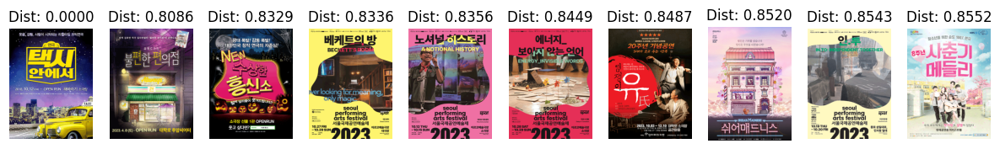

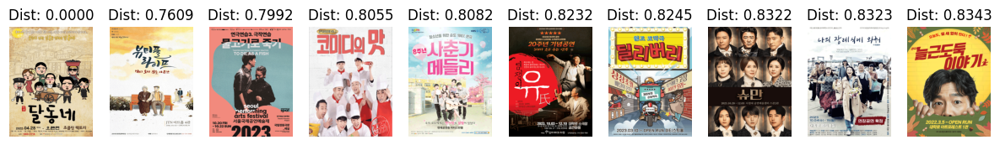

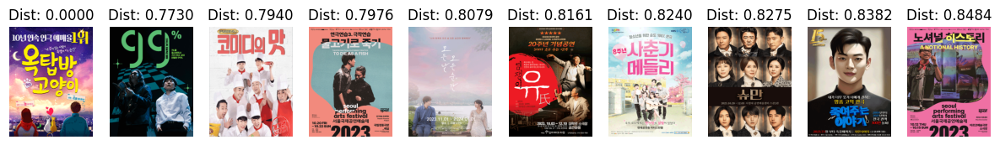

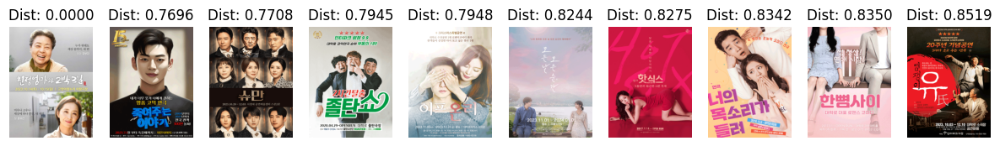

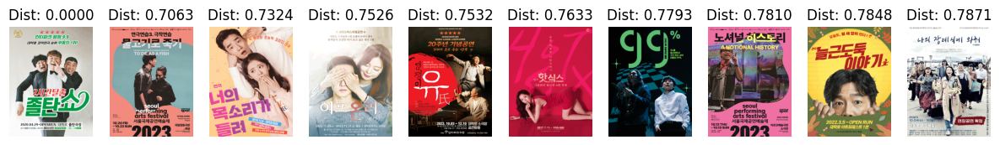

...

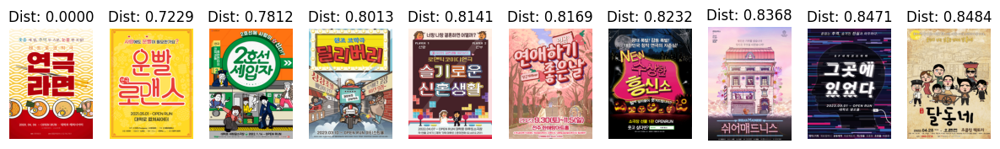

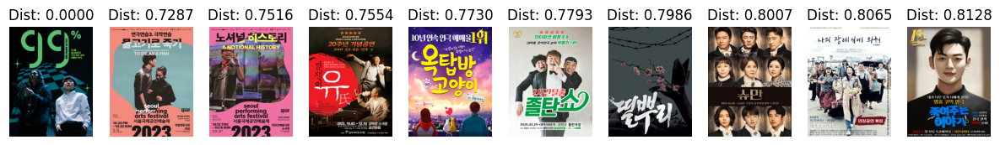

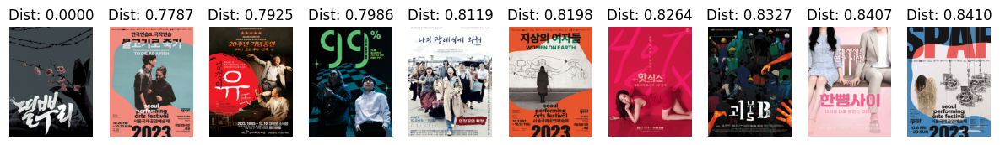

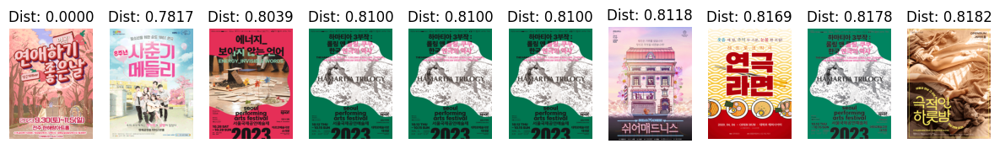

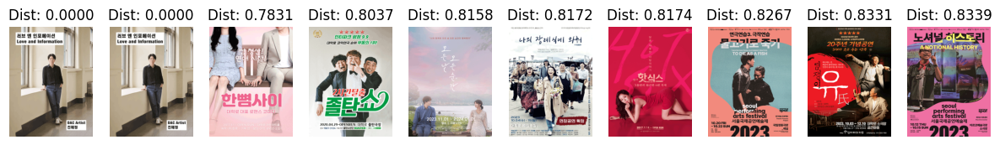

In [15]:
# 포스터 이미지 기반 유사도 높은 상위 9개 출력
for i in range(len(filenames)):
    current_image_index = i
    distances, indices = neighbors.kneighbors([feature_list[current_image_index]])
    similar_image_paths = [filenames[current_image_index]] + [filenames[indices[0][j]] for j in range(1, 10)]
    plot_images(similar_image_paths, distances[0])

In [16]:
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE

[t-SNE] Computing 63 nearest neighbors...
[t-SNE] Indexed 64 samples in 0.000s...
[t-SNE] Computed neighbors for 64 samples in 0.002s...
[t-SNE] Computed conditional probabilities for sample 64 / 64
[t-SNE] Mean sigma: 0.248669
[t-SNE] KL divergence after 250 iterations with early exaggeration: 108.569489
[t-SNE] KL divergence after 1000 iterations: 0.861996


<ipython-input-18-d6f16179ec83>:9: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  colormap = plt.cm.get_cmap('coolwarm')
<ipython-input-18-d6f16179ec83>:10: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  scatter_plot = plt.scatter(tsne_results[:,0],tsne_results[:,1], cmap=colormap)


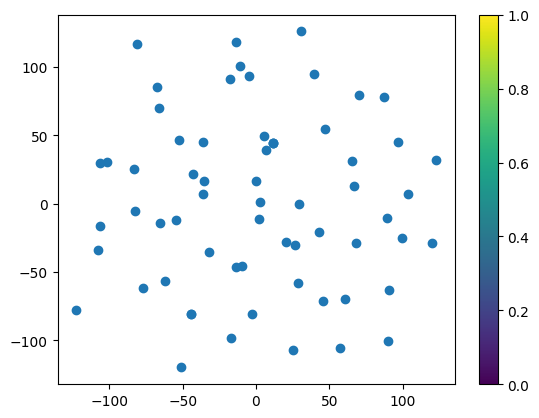

In [18]:
num_feature_dimensions = 6
pca = PCA(n_components = num_feature_dimensions)
feature_list_compressed = pca.fit_transform(feature_list)

selected_features = feature_list_compressed[:64]
selected_filenames = filenames[:64]
tsne_results = TSNE(n_components=3, verbose=1, metric='euclidean').fit_transform(selected_features)
# Plot a scatter plot from the generated t-SNE results
colormap = plt.cm.get_cmap('coolwarm')
scatter_plot = plt.scatter(tsne_results[:,0],tsne_results[:,1], cmap=colormap)
plt.colorbar(scatter_plot)
plt.show()

# Multimodal search

In [ ]:
!pip install sentence_transformers

In [ ]:
from sentence_transformers import SentenceTransformer
model = SentenceTransformer('jhgan/ko-sroberta-multitask')

In [21]:
IMG_SIZE = 224
size = (IMG_SIZE,IMG_SIZE)
img_model = tf.keras.applications.MobileNet(input_shape = (IMG_SIZE, IMG_SIZE, 3), include_top = False, weights = 'imagenet')   # MobileNet
img_model_v = tf.keras.applications.VGG16(input_shape = (IMG_SIZE, IMG_SIZE, 3), include_top = False, weights = 'imagenet')     # VGG16

58889256/58889256 [==============================] - 0s 0us/step


In [22]:
def get_textEmbeddings(model,text):
    text_embedding = model.encode(text, convert_to_tensor=False)
    return text_embedding

In [23]:
def get_imageEmbeddings(model,imagePath):
    image = tf.keras.preprocessing.image.load_img(imagePath,target_size= size)
    input_arr = tf.keras.preprocessing.image.img_to_array(image)
    input_arr = np.array([input_arr])
    img_embeddings = model(input_arr)
    meanImgEmb1 = np.mean(img_embeddings,axis =0)
    meanImgEmb2 = np.mean(meanImgEmb1,axis=0)
    meanImgEmb = np.mean(meanImgEmb2,axis=0)
    return meanImgEmb

In [24]:
df = pd.read_excel('/content/drive/MyDrive/캡스톤/데이터/연극/연극_TOP77_장소병합 (+포스터).xlsx')
df = df.drop(df.columns[0], axis=1)
df.head(3)

,Title,줄거리,장르,Image_path,Image
0,연극 〈운빨로맨스〉- 대학로,점에 살고 점에 죽는 점보늬의 호랑이띠 남자와 하룻밤 보내기 프로젝트 목숨이 걸린 ...,"로맨스, 코믹, 공감/힐링",https://drive.google.com/file/d/1G9xez2Vqh19NE...,연극 〈운빨로맨스〉- 대학로.png
1,(리얼타임 코믹연극) 택시안에서 - 서울,쾌활하고 유쾌한 택시 운전사 민수 그리고 하영과 소희 두 남녀의 운명적인 만남!\n...,"코믹, 로맨스, 공감/힐링",https://drive.google.com/file/d/19p9MpRf8jWMtX...,(리얼타임 코믹연극) 택시안에서 - 서울.png
2,(코믹연극) 달동네-부산,"정음의 아버지 경민은 행정착오로 인해 월남전 참전 중 전사자 처리가 되고,........","코믹, 감동, 드라마",https://drive.google.com/file/d/11JRcnHFBX7gdF...,(코믹연극) 달동네-부산.gif


In [25]:
df['줄거리'] = df['줄거리'].apply(lambda x: re.sub(r'[^가-힣a-zA-Z\s]', '', x))

In [26]:
print(np.shape(df))

(64, 5)


In [27]:
# MobileNet으로 임베딩

text_embeddings={}
image_embeddings={}
start_time = time.time()

for index,row in  df.iterrows():
    txt_emb = get_textEmbeddings(model, str(row[1]))    # 줄거리
    imagePath = '/content/drive/MyDrive/캡스톤/데이터/연극/연극_포스터/'+row[4]   # 이미지 경로
    img_emb = get_imageEmbeddings(img_model, imagePath)
    text_embeddings[row[0]] = txt_emb
    image_embeddings[row[0]] = img_emb
end_time = time.time()
print(str(end_time-start_time))

4.67362117767334


In [28]:
# VGG16으로 임베딩

text_embeddings={}
image_embeddings={}
start_time = time.time()
for index,row in  df.iterrows():
    txt_emb = get_textEmbeddings(model, str(row[1]))
    imagePath = '/content/drive/MyDrive/캡스톤/데이터/연극/연극_포스터/'+row[4]
    img_emb = get_imageEmbeddings(img_model_v, imagePath)
    text_embeddings[row[0]] = txt_emb
    image_embeddings[row[0]] = img_emb
end_time = time.time()
print(str(end_time-start_time))

2.5728113651275635


In [ ]:
keyList=[]    # 줄거리
cembList=[]   # 줄거리 + 포스터 concate
imageList=[]  # 포스터
titleList=[]  # 제목
for index, row in df.iterrows():

    txt_emb = text_embeddings[row[0]]
    print(np.shape(txt_emb))
    img_emb = image_embeddings[row[0]]
    print(np.shape(img_emb))
    cmb_emb = np.concatenate((txt_emb,img_emb),axis=0)
    print(np.shape(cmb_emb))
    norm = np.linalg.norm(cmb_emb)
    cmb_emb_normal = cmb_emb/norm
    keyList.append(row[1])
    cembList.append(cmb_emb_normal)
    imageList.append(row[4])
    titleList.append(row[0])

##### KNN 알고리즘 사용

In [30]:
from sklearn.neighbors import NearestNeighbors
kneigh = NearestNeighbors(n_neighbors=5,leaf_size=5000,algorithm='kd_tree')
kneigh.fit(cembList)

NearestNeighbors(algorithm='kd_tree', leaf_size=5000)

In [39]:
def getNeighbours(query_emb):
    posting_id_list=[]
    neigh_dist,neigh_ind = kneigh.kneighbors(X=query_emb.reshape(1,-1), n_neighbors=10, return_distance=True)  # 10개의 유사도
    for ind in neigh_ind:
        #print(str(ind))
        for ind1 in ind:
            posting_id_list.append(str(ind1))
    return posting_id_list

In [40]:
postingidList=[]
matchesList=[]
index =0
for val in keyList:
    query_emb = cembList[index]
    postingid_list = getNeighbours(query_emb)
    postingidList.append(val)
    matchesList.append(" ".join(postingid_list))
    index =index +1
    if index==65:
        break

##### 코사인 유사도 사용

In [41]:
def get_cosine_similarities(query_emb, emb_list):
    similarities = cosine_similarity(query_emb.reshape(1, -1), emb_list)
    return similarities.flatten()

In [42]:
def get_top_n_similar(query_emb, emb_list, n=10):  # 10개의 유사도
    similarities = get_cosine_similarities(query_emb, emb_list)
    top_indices = similarities.argsort()[-n:][::-1]
    return top_indices

In [43]:
postingidList = []
matchesList = []
index = 0

for val, query_emb in zip(keyList, cembList):
    top_indices = get_top_n_similar(query_emb, cembList)
    postingid_list = [str(i) for i in top_indices]
    postingidList.append(val)
    matchesList.append(" ".join(postingid_list))
    index += 1
    if index == 65:
        break

연극 〈운빨로맨스〉- 대학로


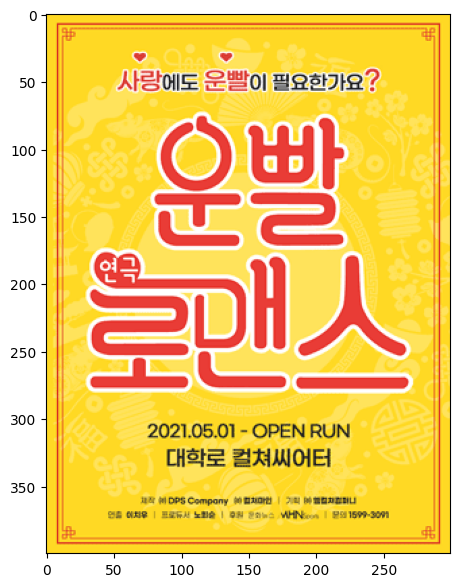

연극 〈운빨로맨스〉- 대학로


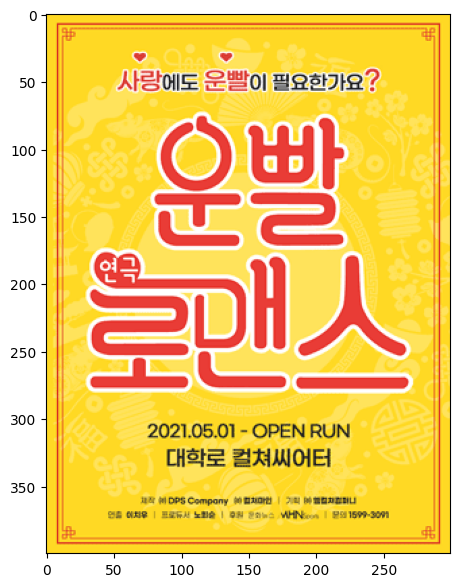

［2023 SPAF］ 지연X전환 〈에너지_보이지 않는 언어〉


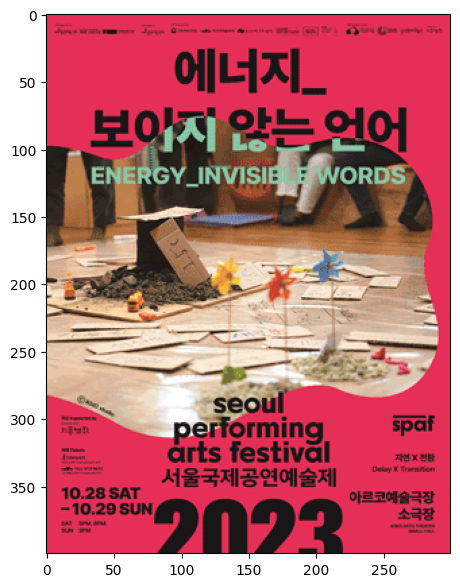

대학로 청소년연극 〈사춘기메들리〉


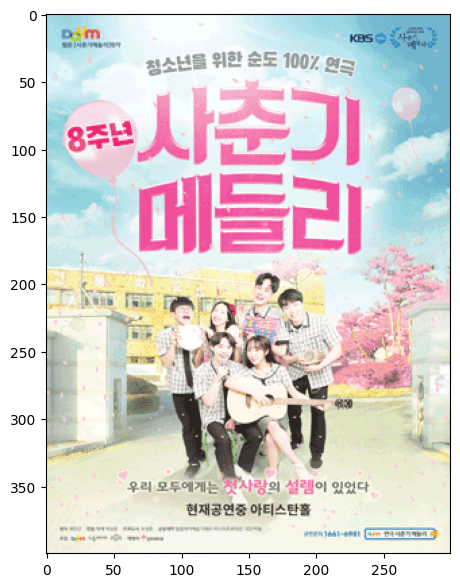

［연애하기 좋은 날  당근거래］ - 전주


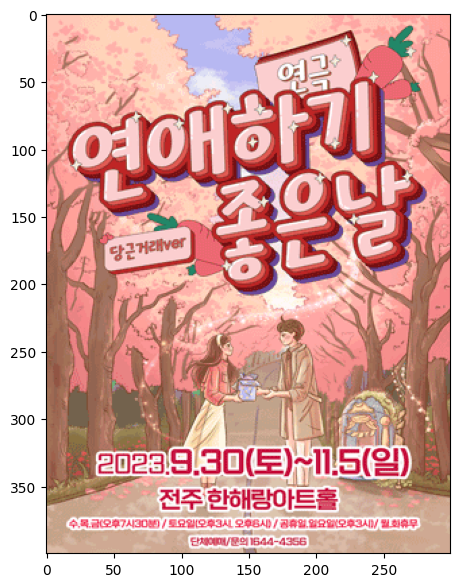

국민 코믹 연극 〈오백에삼십〉 - 대학로 세우아트센터 1관


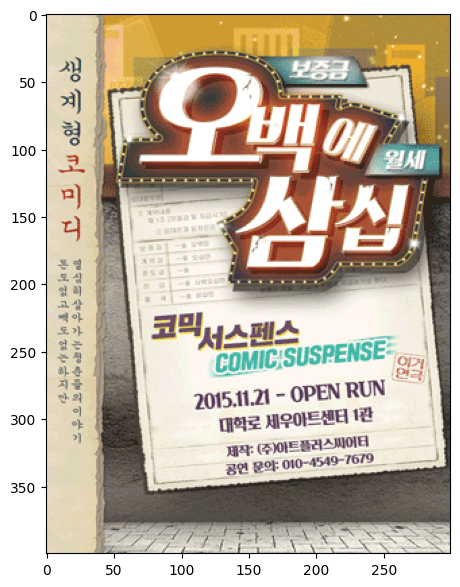

［2023’셀러브리티 로코연극］러브액츄얼리 첫번째사연_크리스마스 특별공연 - 부산


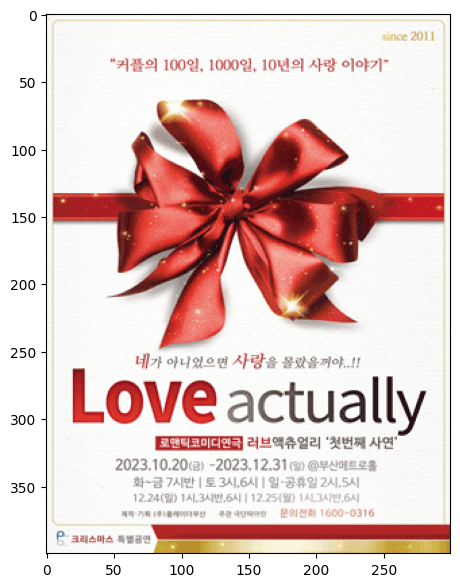

［2023 SPAF］ 파이브 아트 센터 〈노셔널 히스토리〉


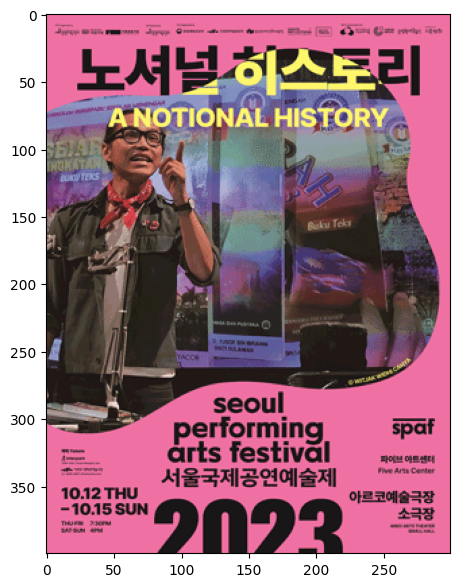

2시간탈출 졸탄쇼


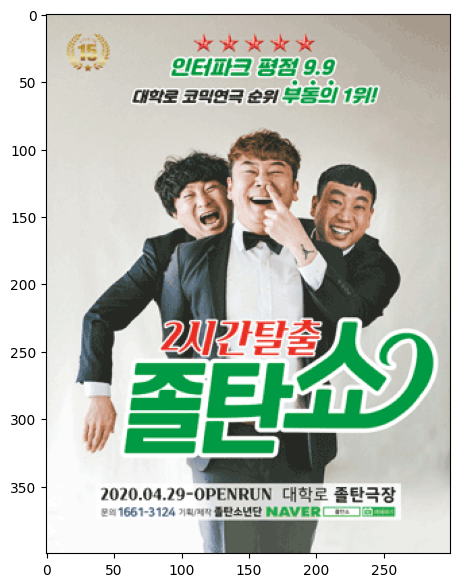

연극 〈뷰티풀라이프〉


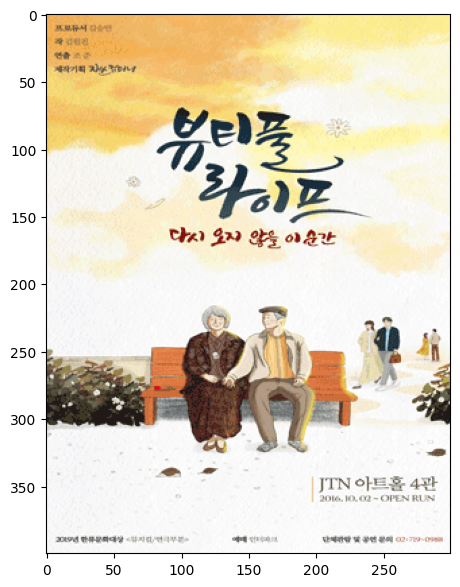

［2023 SPAF］ 극단 골목길 〈이장〉


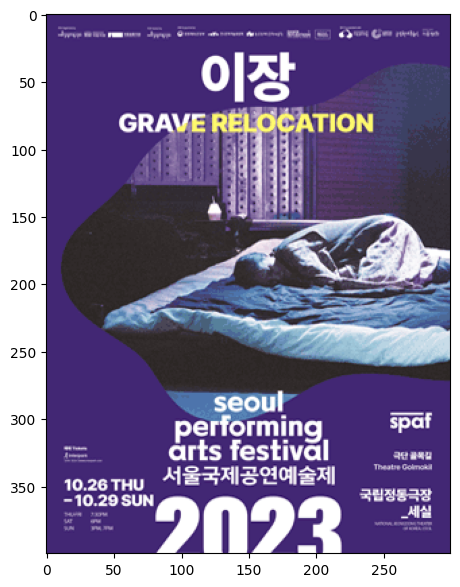

(리얼타임 코믹연극) 택시안에서 - 서울


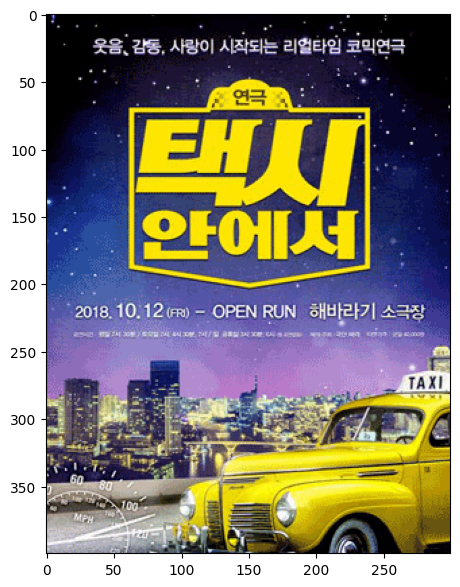

(리얼타임 코믹연극) 택시안에서 - 서울


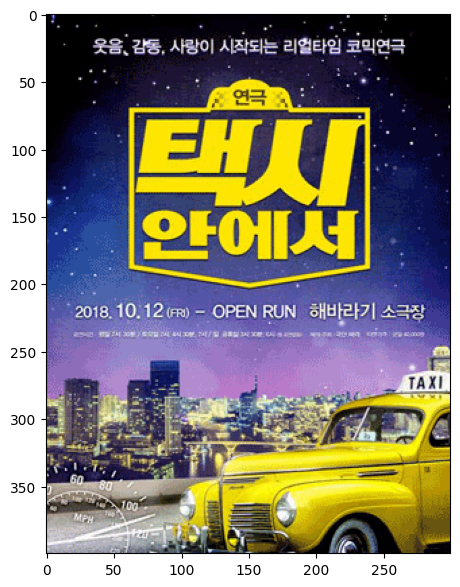

10년 연속 1위 연극〈옥탑방고양이〉- 틴틴홀


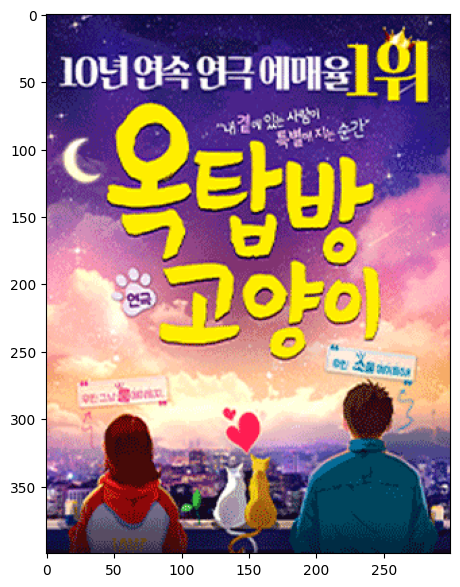

［2023 SPAF］ 파이브 아트 센터 〈노셔널 히스토리〉


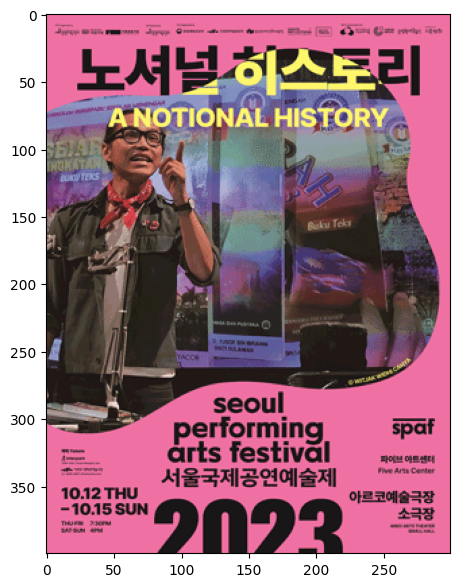

3대가 웃고 우는 연극 〈염쟁이 유씨〉


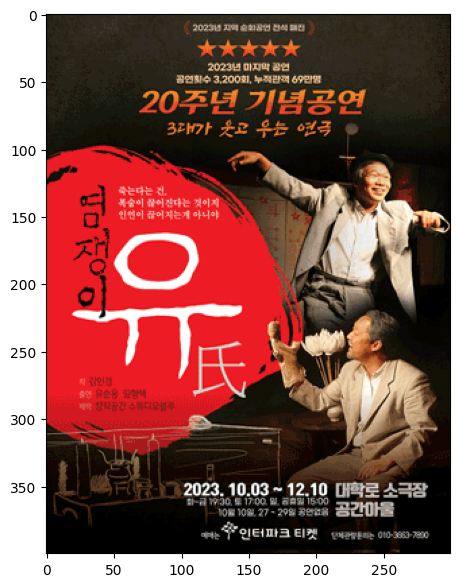

［연애하기 좋은 날  당근거래］ - 전주


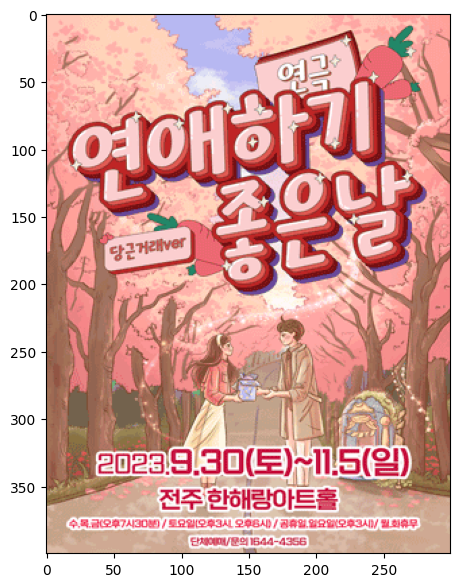

［2023 SPAF］ 극단 골목길 〈이장〉


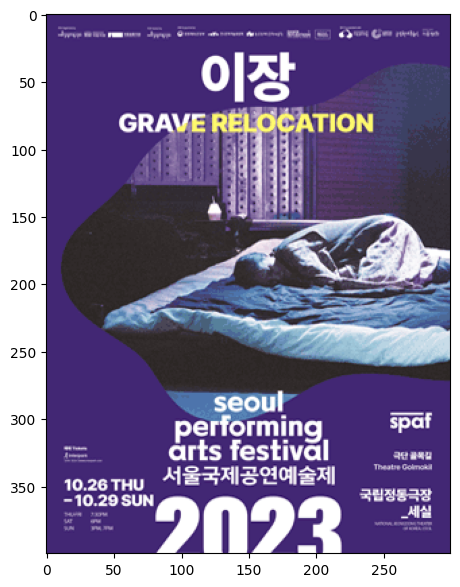

연극 〈수상한흥신소〉


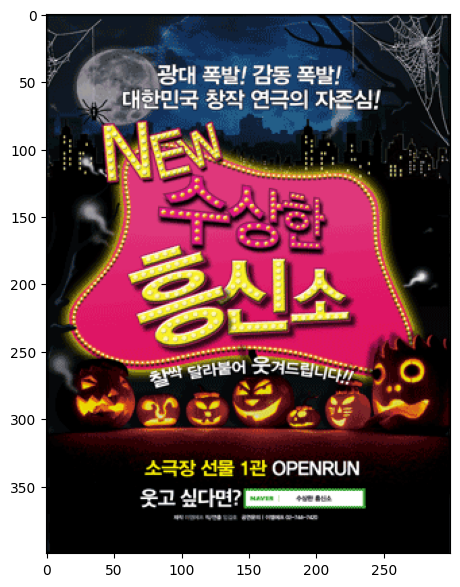

［2023 SPAF］ 지연X전환 〈에너지_보이지 않는 언어〉


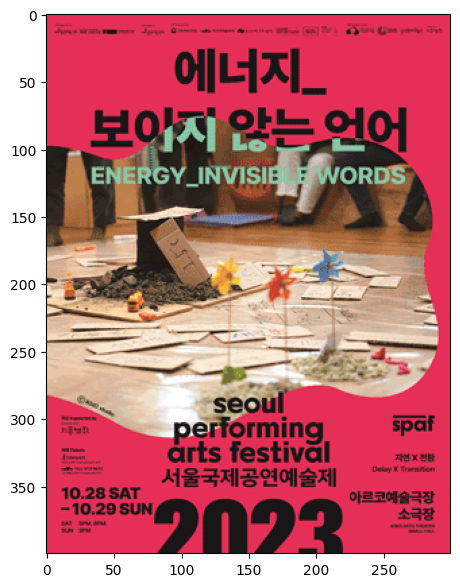

연극 〈카페 쥬에네스〉


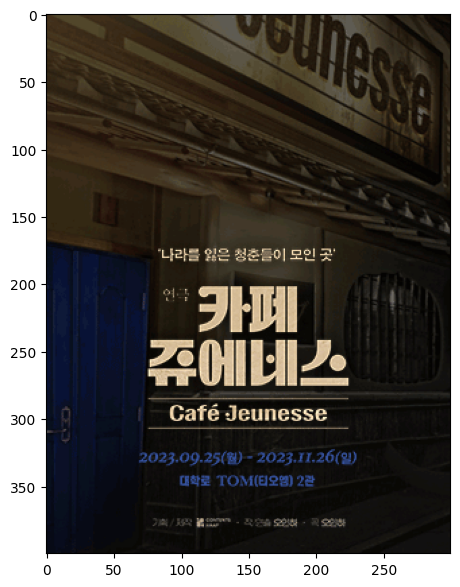

［2023 SPAF］ 데드센터 〈베케트의 방〉


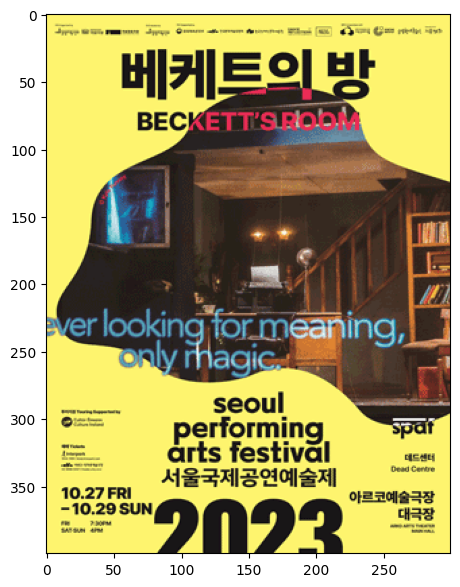

(코믹연극) 달동네-부산


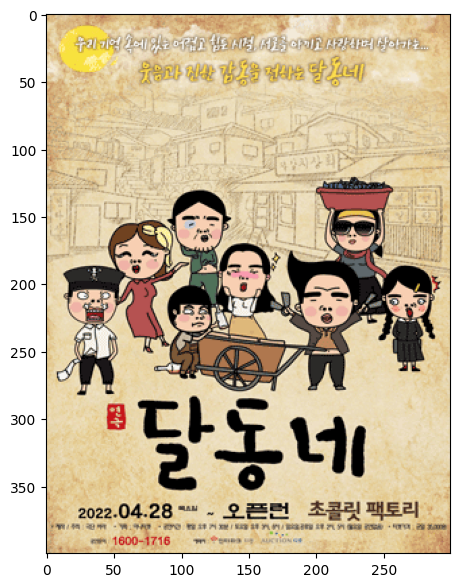

(코믹연극) 달동네-부산


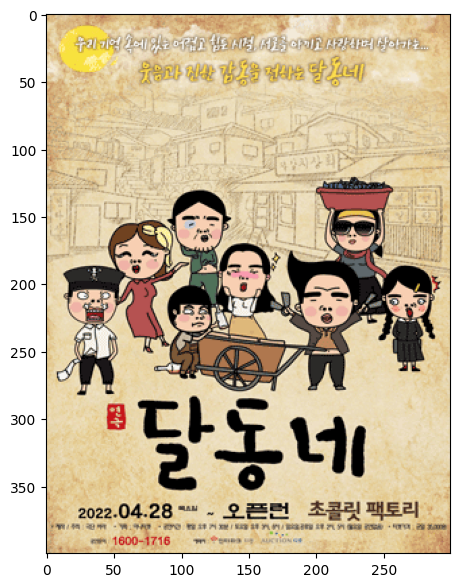

대학로 청소년연극 〈사춘기메들리〉


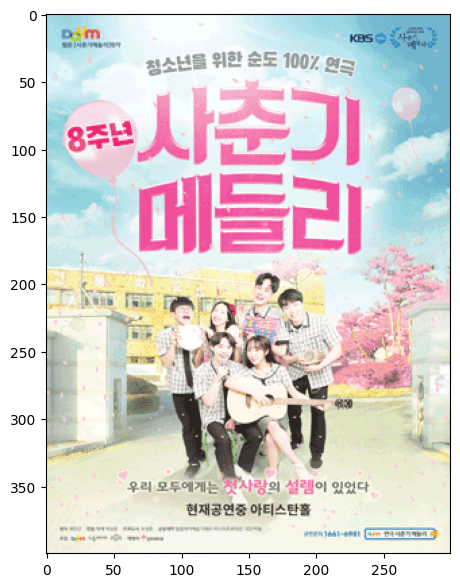

［연애하기 좋은 날  당근거래］ - 전주


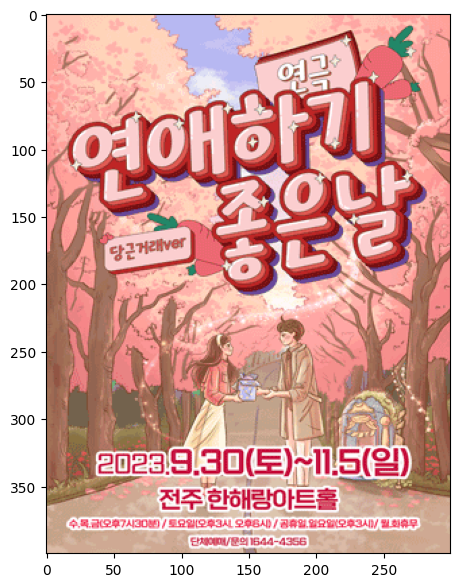

［2023 SPAF］ 지연X전환 〈에너지_보이지 않는 언어〉


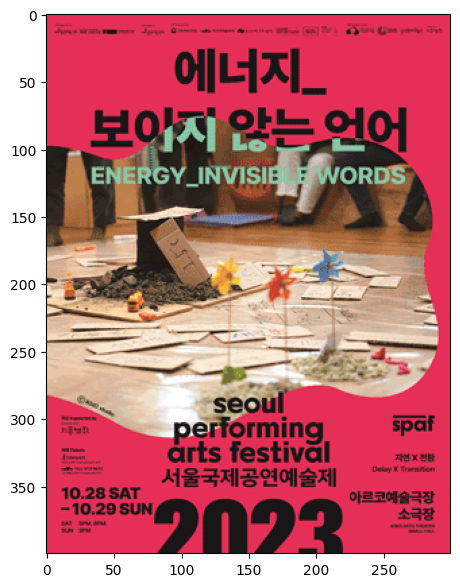

나의 장례식에 와줘


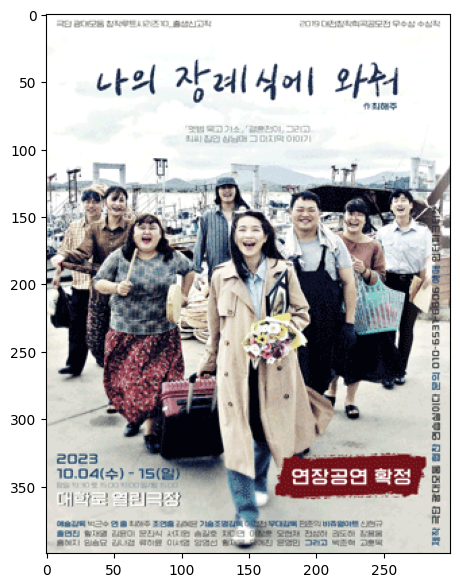

［2023 SPAF］ 연극연습 프로젝트 〈연극연습3. 극작 연습-물고기로 죽기〉


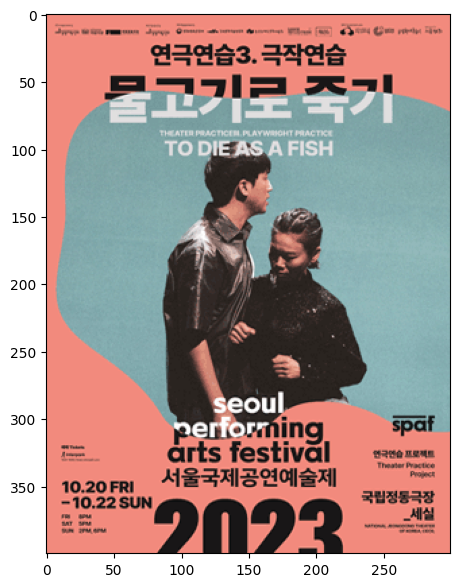

연극 〈수상한흥신소〉


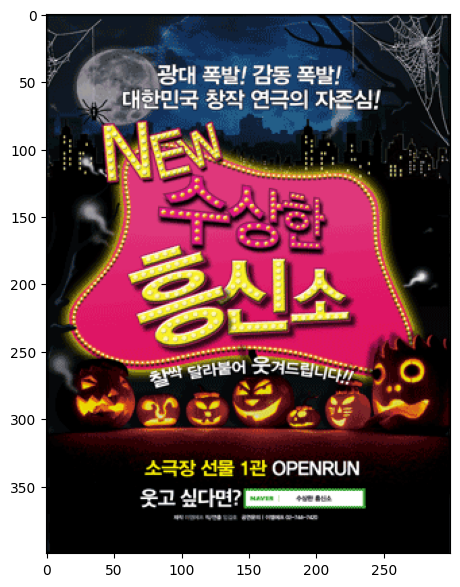

공포연극 ［자취］


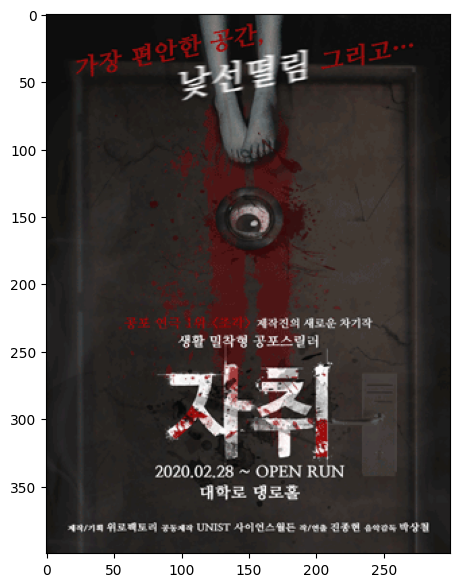

［2023 SPAF］ 데드센터 〈베케트의 방〉


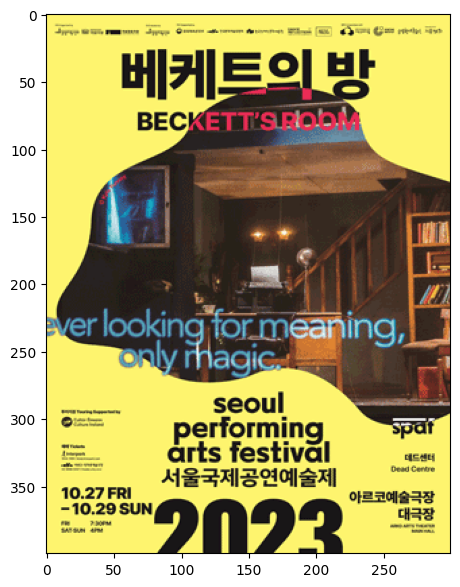

［2023 SPAF］ 작당모의 〈싸움의 기술, 〈졸〉_2.0〉


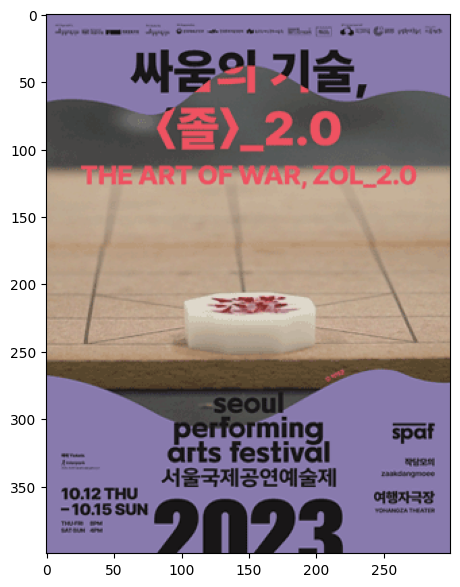

In [45]:
# 유사도가 높은 상위 10개의 이미지 출력
## Mobilenet + KNN

%matplotlib inline
index =0
for item in postingidList:
    print(titleList[index])
    # print(keyList[index])
    imagePath = '/content/drive/MyDrive/캡스톤/데이터/연극/연극_포스터/'+ imageList[index]
    pil_im = Image.open(imagePath, 'r')
    plt.figure(figsize=(7, 7))
    plt.imshow(pil_im)
    plt.show()
    matching_indices = matchesList[index].split(' ')
    print('==================')
    for ind in matching_indices:
        print(titleList[int(ind)])
        # print(keyList[int(ind)])
        imagePath = '/content/drive/MyDrive/캡스톤/데이터/연극/연극_포스터/'+ imageList[int(ind)]
        pil_im = Image.open(imagePath, 'r')
        plt.figure(figsize=(7,7))
        plt.imshow(pil_im)
        plt.show()
    index= index +1
    # 전체 데이터 사용 시 변경
    if index == 3:
        break

In [ ]:
## Mobilenet + 코사인 유사도

%matplotlib inline
index =0
for item in postingidList:
    print(titleList[index])
    # print(keyList[index])
    # 코사인 유사도 값 출력
    matching_indices = matchesList[index].split(' ')
    similarities = [cosine_similarity(cembList[index].reshape(1, -1), cembList[int(ind)].reshape(1, -1))[0][0] for ind in matching_indices]
    print("Cosine Similarities:", similarities)

    imagePath = '/content/drive/MyDrive/캡스톤/데이터/연극/연극_포스터/'+ imageList[index]
    pil_im = Image.open(imagePath, 'r')
    plt.figure()
    plt.imshow(pil_im)
    plt.show()
    matching_indices = matchesList[index].split(' ')
    print('==================')
    for ind in matching_indices:
        print(titleList[int(ind)])
        # print(keyList[int(ind)])
        imagePath = '/content/drive/MyDrive/캡스톤/데이터/연극/연극_포스터/'+ imageList[int(ind)]
        pil_im = Image.open(imagePath, 'r')
        plt.figure()
        plt.imshow(pil_im)
        plt.show()
    index= index +1
    if index == 63:
        break

In [ ]:
## VGG16 + KNN

%matplotlib inline
index =0
for item in postingidList:
    print(titleList[index])
    # print(keyList[index])
    imagePath = '/content/drive/MyDrive/캡스톤/데이터/연극/연극_포스터/'+ imageList[index]
    pil_im = Image.open(imagePath, 'r')
    plt.figure()
    plt.imshow(pil_im)
    plt.show()
    matching_indices = matchesList[index].split(' ')
    print('==================')
    for ind in matching_indices:
        print(titleList[int(ind)])
        # print(keyList[int(ind)])
        imagePath = '/content/drive/MyDrive/캡스톤/데이터/연극/연극_포스터/'+ imageList[int(ind)]
        pil_im = Image.open(imagePath, 'r')
        plt.figure()
        plt.imshow(pil_im)
        plt.show()
    index= index +1
    if index == 63:
        break